In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
from skimage import feature
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score,davies_bouldin_score, calinski_harabasz_score
from google.colab import drive
import os
from mpl_toolkits.mplot3d import Axes3D
import glob
from sklearn.metrics import silhouette_score

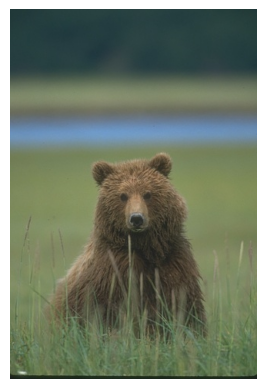

In [ ]:
os.chdir('/content/drive/MyDrive/GMM')

image_path = '100080.jpg'
image = Image.open(image_path)

plt.imshow(image)
plt.axis('off')
plt.show()

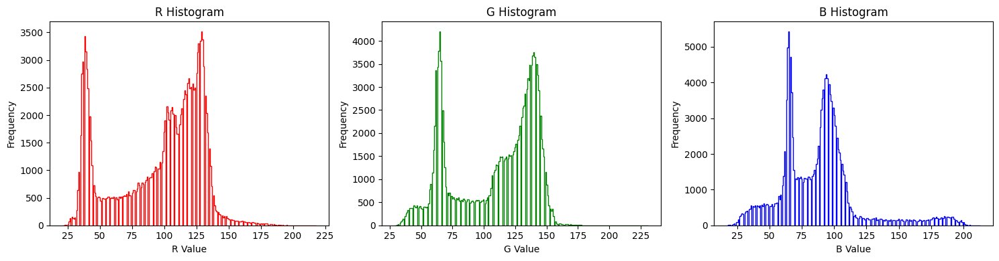

In [ ]:
image_np = np.array(image)

r_channel = image_np[:, :, 0]
g_channel = image_np[:, :, 1]
b_channel = image_np[:, :, 2]

plt.figure(figsize=(15, 4))

plt.subplot(131)
plt.hist(r_channel.ravel(), bins=256, color='r', histtype='step')
plt.title('R Histogram')
plt.xlabel('R Value')
plt.ylabel('Frequency')

plt.subplot(132)
plt.hist(g_channel.ravel(), bins=256, color='g', histtype='step')
plt.title('G Histogram')
plt.xlabel('G Value')
plt.ylabel('Frequency')

plt.subplot(133)
plt.hist(b_channel.ravel(), bins=256, color='b', histtype='step')
plt.title('B Histogram')
plt.xlabel('B Value')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

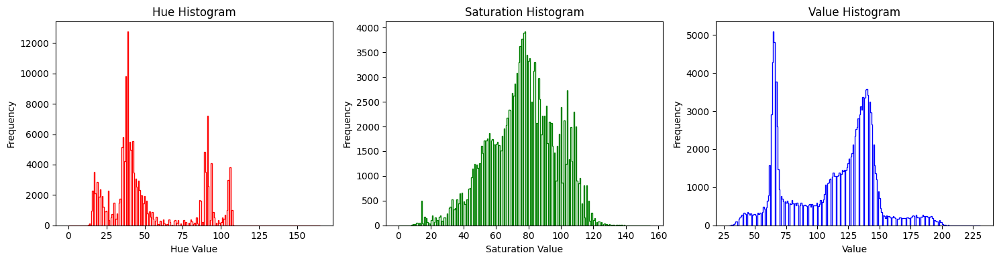

In [ ]:
image_hsv = cv2.cvtColor(image_np, cv2.COLOR_RGB2HSV)

hue_channel = image_hsv[:, :, 0]
saturation_channel = image_hsv[:, :, 1]
value_channel = image_hsv[:, :, 2]

plt.figure(figsize=(15, 4))

plt.subplot(131)
plt.hist(hue_channel.ravel(), bins=256, color='r', histtype='step')
plt.title('Hue Histogram')
plt.xlabel('Hue Value')
plt.ylabel('Frequency')

plt.subplot(132)
plt.hist(saturation_channel.ravel(), bins=256, color='g', histtype='step')
plt.title('Saturation Histogram')
plt.xlabel('Saturation Value')
plt.ylabel('Frequency')

plt.subplot(133)
plt.hist(value_channel.ravel(), bins=256, color='b', histtype='step')
plt.title('Value Histogram')
plt.xlabel('Value')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()


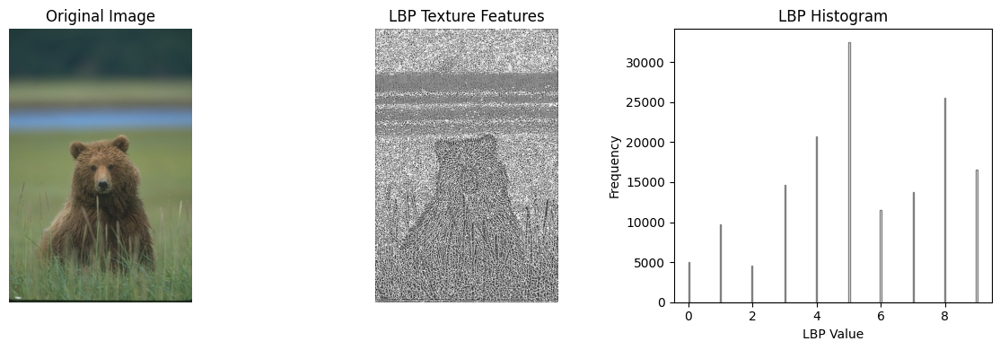

In [ ]:
image_gray = cv2.cvtColor(image_np, cv2.COLOR_RGB2GRAY)

radius = 1
n_points = 8 * radius
lbp_features = feature.local_binary_pattern(image_gray, n_points, radius, method="uniform")


plt.figure(figsize=(12, 4))

plt.subplot(131)
plt.imshow(image_np)
plt.title('Original Image')
plt.axis('off')

plt.subplot(132)
plt.imshow(lbp_features, cmap='gray')
plt.title('LBP Texture Features')
plt.axis('off')

plt.subplot(133)
plt.hist(lbp_features.ravel(), bins=256, color='gray', histtype='step')
plt.title('LBP Histogram')
plt.xlabel('LBP Value')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

In [ ]:
def run_gmm(K, features, image):
  gmm = GaussianMixture(n_components=K,covariance_type="tied")
  gmmFull = GaussianMixture(n_components=K,covariance_type="full")
  gmm.fit(features)
  gmmFull.fit(features)

  cluster_assignments = gmm.predict(features)
  cluster_assignments_full = gmmFull.predict(features)

  segmentation = cluster_assignments.reshape(image.shape[:2])

  segmentation2 = cluster_assignments_full.reshape(image.shape[:2])

  plt.figure(figsize=(10, 5))

  plt.subplot(1, 3, 1)
  plt.imshow(image)
  plt.title('Original Image')
  plt.axis('off')


  plt.subplot(1, 3, 2)
  plt.imshow(segmentation)
  plt.title(f'Segmentation K={K} - Covariance tied')
  plt.axis('off')

  plt.subplot(1, 3, 3)
  plt.imshow(segmentation2)
  plt.title(f'Segmentation K={K} - Covariance full')
  plt.axis('off')

  plt.tight_layout()
  plt.show()

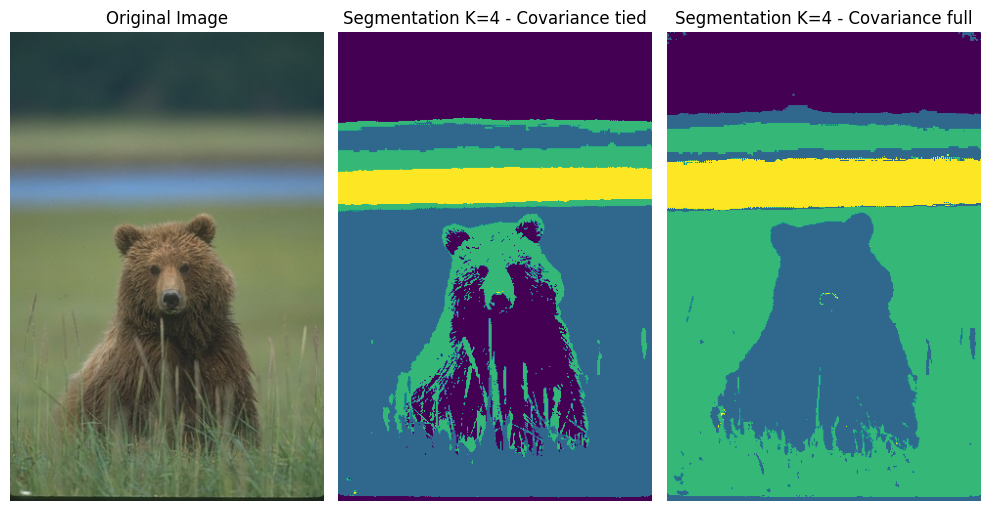

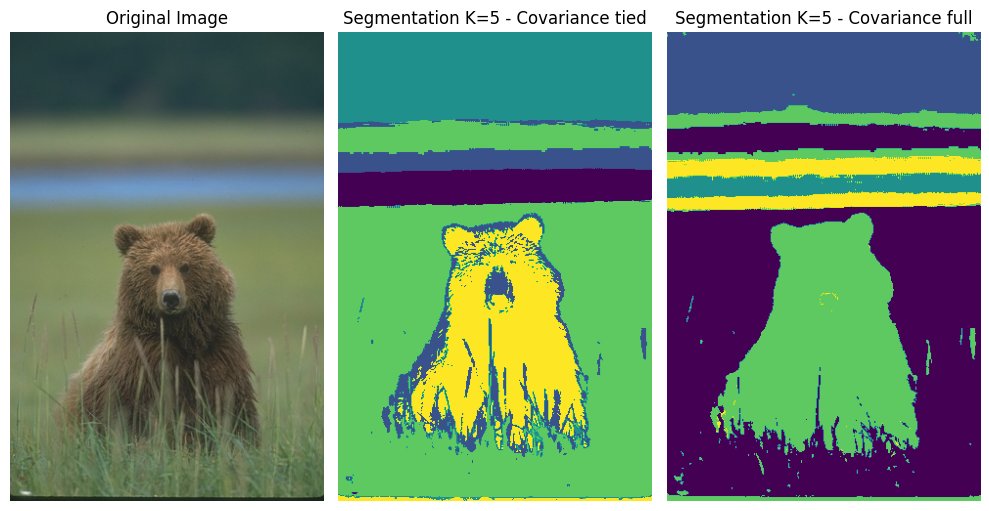

In [ ]:
rgb_color_feature_vector = image_np.reshape((-1, 3))

run_gmm(K=4, features=rgb_color_feature_vector, image=image_np)
run_gmm(K=5, features=rgb_color_feature_vector, image=image_np)

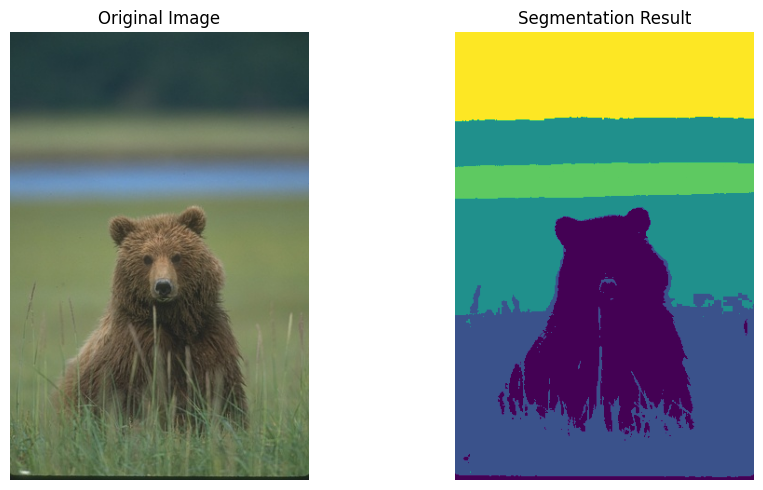

In [ ]:
rows, cols, _ = image_np.shape
x, y = np.meshgrid(np.arange(cols), np.arange(rows))
coordinate_features = np.column_stack((x.flatten(), y.flatten()))

rgb_xy_features = np.concatenate((rgb_color_feature_vector, coordinate_features), axis=1)

run_gmm(K=5, features=rgb_xy_features, image=image_np)

In [ ]:
hsv_color_feature_vector = image_hsv.reshape((-1, 3))
lbp_feature_vector = lbp_features.ravel().reshape(-1,1)
hsv_lbp_feature_vector = np.concatenate((hsv_color_feature_vector, lbp_feature_vector),axis=-1)


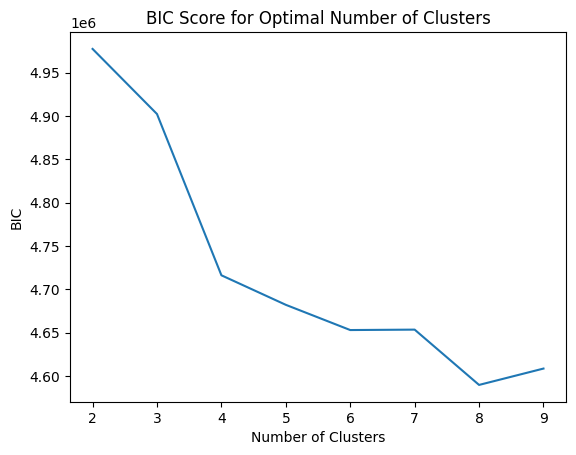

In [ ]:
n_components=np.arange(2,10)

gmm_models=[GaussianMixture(n,covariance_type="tied").fit(hsv_lbp_feature_vector) for n in n_components]

plt.plot(n_components, [m.bic(hsv_lbp_feature_vector) for m in gmm_models])
plt.xlabel('Number of Clusters')
plt.ylabel('BIC')
plt.title('BIC Score for Optimal Number of Clusters')
plt.show()

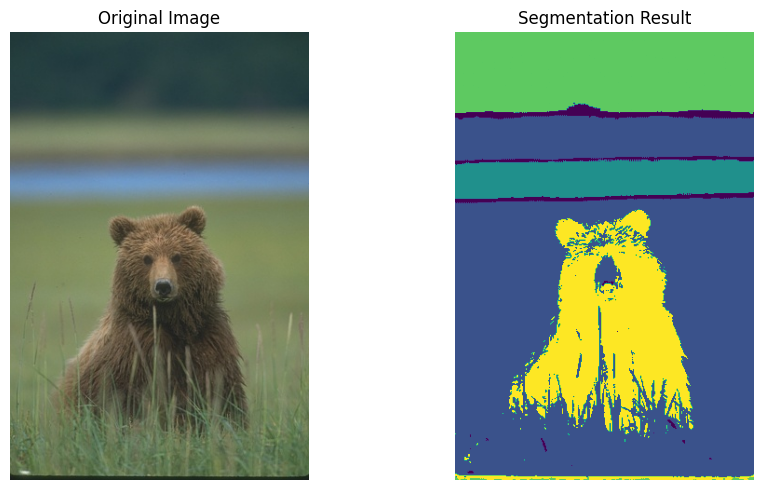

In [ ]:
run_gmm(K=5, features=hsv_lbp_feature_vector, image=image_np)

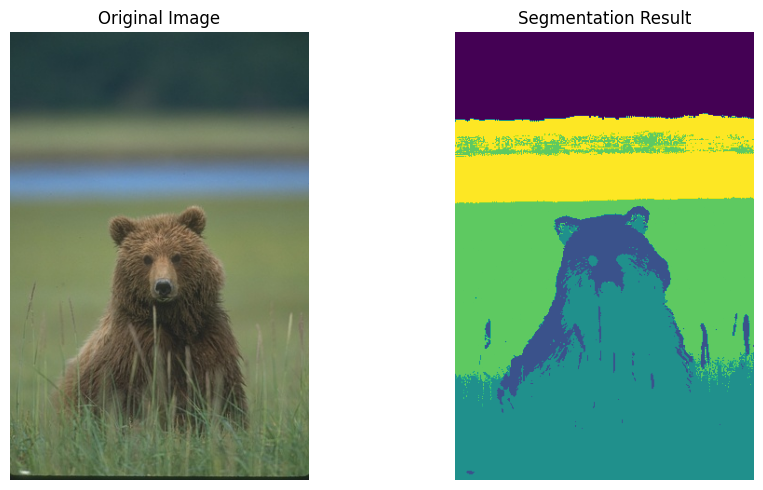

In [ ]:
from sklearn.preprocessing import MinMaxScaler
hsv_lbp_xy_feature_vector = np.concatenate((rgb_color_feature_vector, lbp_feature_vector,coordinate_features),axis=-1)

scaler = MinMaxScaler()
normalized_features = scaler.fit_transform(hsv_lbp_xy_feature_vector)

run_gmm(K=5, features=normalized_features, image=image_np)

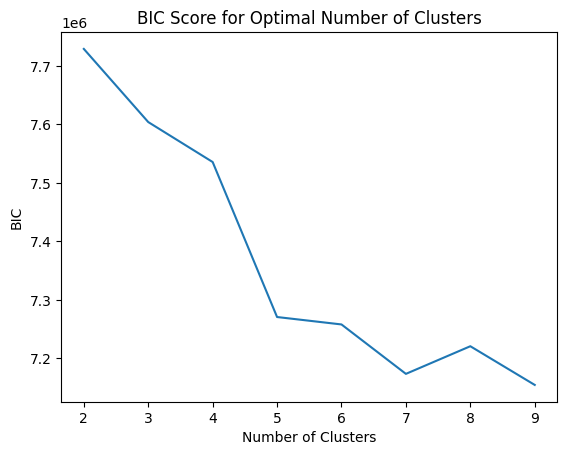

In [ ]:
n_components=np.arange(2,10)

gmm_models=[GaussianMixture(n,covariance_type="tied").fit(rgb_xy_features) for n in n_components]

plt.plot(n_components, [m.bic(rgb_xy_features) for m in gmm_models])
plt.xlabel('Number of Clusters')
plt.ylabel('BIC')
plt.title('BIC Score for Optimal Number of Clusters')
plt.show()

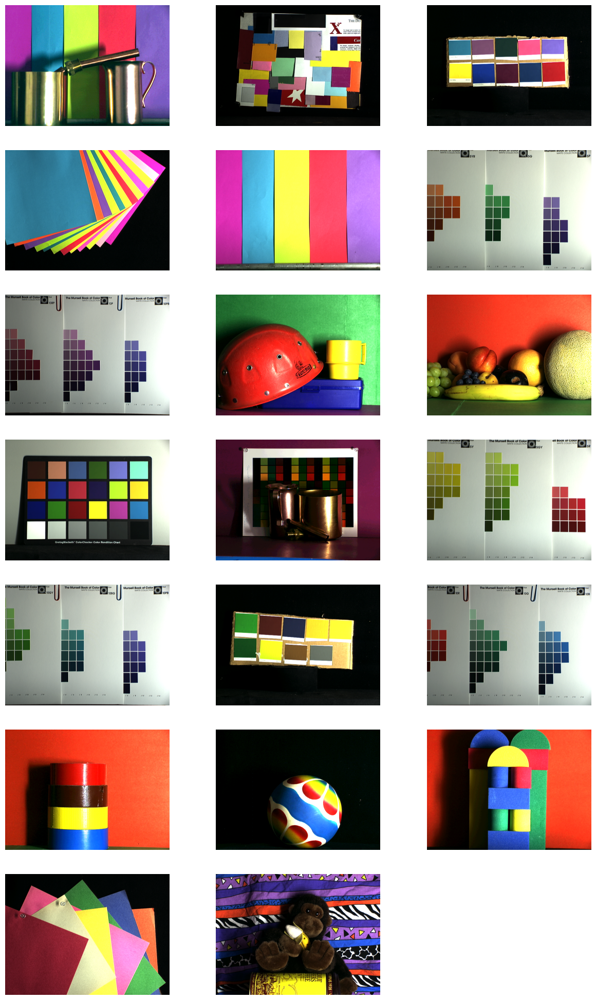

In [ ]:
folder_path = '/content/drive/MyDrive/GMM/color_images/images'

image_files = glob.glob(folder_path + '/*.tif')

num_images = len(image_files)
rows = (num_images // 3) + 1
cols = 3

fig, axs = plt.subplots(rows, cols, figsize=(15, 25))

images_ds1=[]

for i, image_file in enumerate(image_files):
    row = i // cols
    col = i % cols
    img = Image.open(image_file)
    images_ds1.append(np.array(img))

    axs[row, col].imshow(img)
    axs[row, col].axis('off')

for i in range(num_images, rows * cols):
    axs.flat[i].set_visible(False)

plt.show()

In [ ]:
def find_optimal_number_of_clusters(features):
  k_min = 2
  k_max = 15

  bic_scores = []
  for k in range(k_min, k_max + 1):
    gmm = GaussianMixture(n_components=k,covariance_type="full")
    gmm.fit(features)
    bic_scores.append(gmm.bic(features))

  bic_diff = np.diff(bic_scores)

  elbow_point = np.argmax(np.abs(bic_diff)) + k_min + 1
  return elbow_point

In [ ]:
def gmm_cluster(K, features):
  gmm = GaussianMixture(n_components=K,covariance_type="full")
  gmm.fit(features)

  cluster_assignments = gmm.predict(features)
  bic_score=gmm.bic(features)

  return cluster_assignments, bic_score

In [ ]:
def plot_optimal_number_of_clusters(images):

  for image in images:
    rgb_features=image.reshape((-1, 3))

    n_components=np.arange(2,15)

    gmm_models=[GaussianMixture(n,covariance_type="full").fit(rgb_features) for n in n_components]

    plt.figure(figsize=(12, 4))

    plt.subplot(1, 2, 1)
    plt.imshow(image, cmap='gray')
    plt.title('Original Image')

    plt.subplot(1, 2, 2)
    plt.plot(n_components, [m.bic(rgb_features) for m in gmm_models])
    plt.xlabel('Number of Clusters')
    plt.ylabel('BIC')
    plt.title('BIC Score for Optimal Number of Clusters')
    plt.show()

In [ ]:
plot_optimal_number_of_clusters(images_ds1)

In [ ]:
number_of_clusters_ds1=[6,11,6,5,6,4,5,7,5,6,6,4,5,3,5,5,5,5,7,8]

In [ ]:
def plot_images_with_segmentation(images, number_of_clusters):
    all_features=[]
    all_features_hsv=[]
    all_labels=[]
    all_labels_hsv=[]
    all_bic=[]
    all_bic_hsv=[]
    for image,clusters in zip(images,number_of_clusters):
        rgb_features=image.reshape((-1, 3))
        hsv_features=cv2.cvtColor(image, cv2.COLOR_RGB2HSV).reshape((-1, 3))
        all_features.append(rgb_features)
        all_features_hsv.append(hsv_features)

        labels, bic = gmm_cluster(clusters, rgb_features)
        labels_hsv, bic_hsv=gmm_cluster(clusters,hsv_features)
        all_labels.append(labels)
        all_labels_hsv.append(labels_hsv)
        all_bic.append(bic)
        all_bic_hsv.append(bic_hsv)
        segmentation=labels.reshape(image.shape[:2])
        segmentation_hsv=labels_hsv.reshape(image.shape[:2])

        plt.figure(figsize=(12, 4))

        plt.subplot(1, 3, 1)
        plt.imshow(image, cmap='gray')
        plt.title('Original Image')

        plt.subplot(1, 3, 2)
        plt.imshow(segmentation, cmap='viridis')
        plt.title(f' RGB Segmented Image (Clusters: {clusters})')

        plt.subplot(1, 3, 3)
        plt.imshow(segmentation_hsv, cmap='viridis')
        plt.title(f' HSV Segmented Image (Clusters: {clusters})')

        plt.tight_layout()
        plt.show()

    return all_features, all_labels, all_bic, all_features_hsv, all_labels_hsv, all_bic_hsv

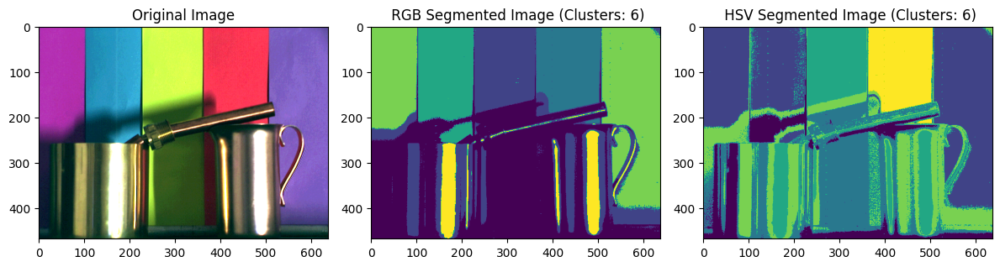

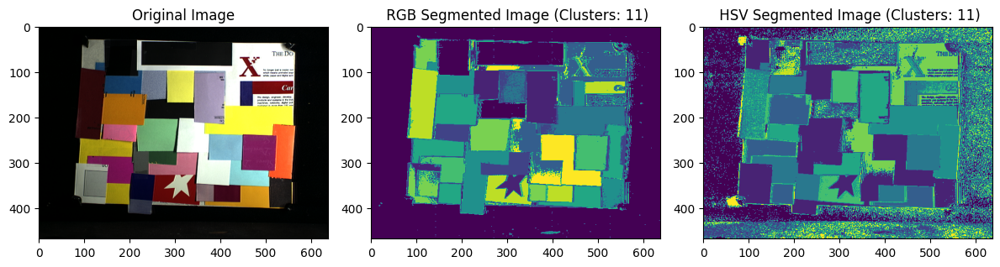

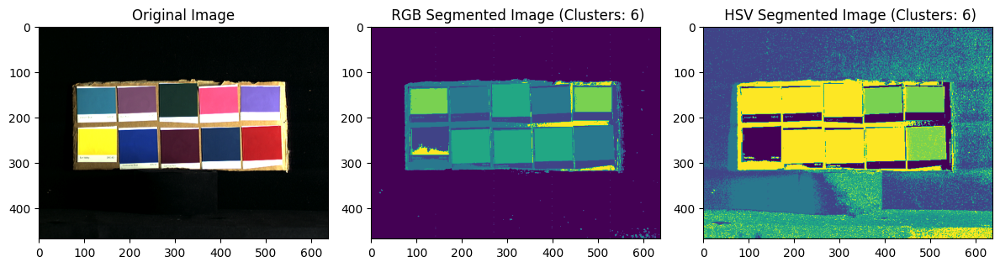

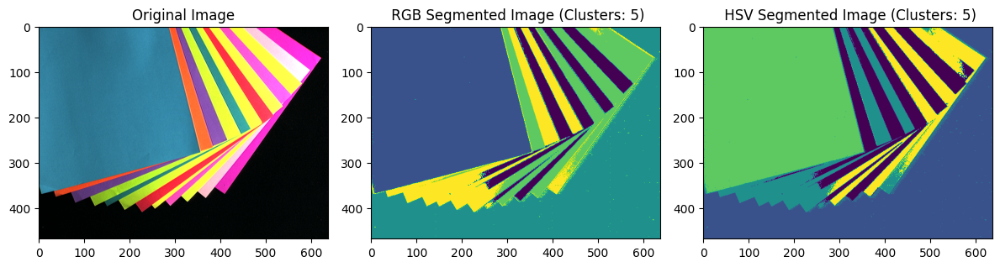

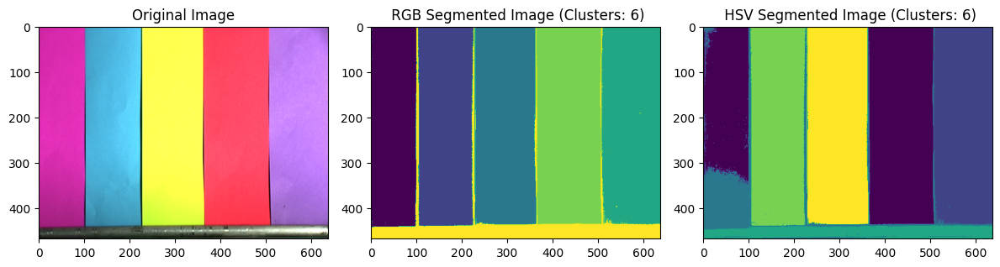

...

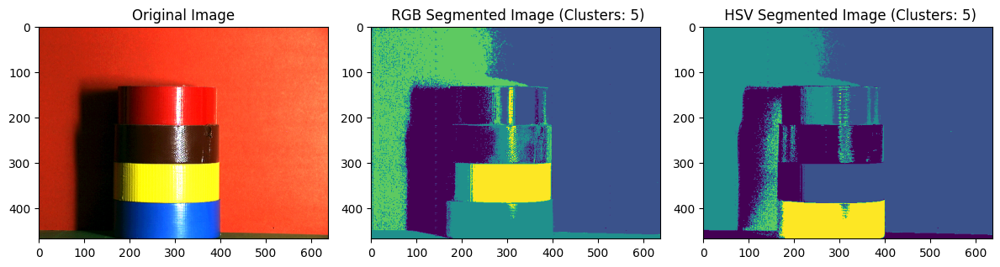

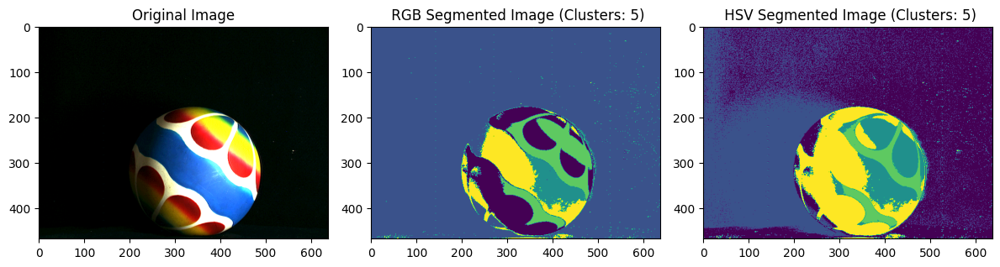

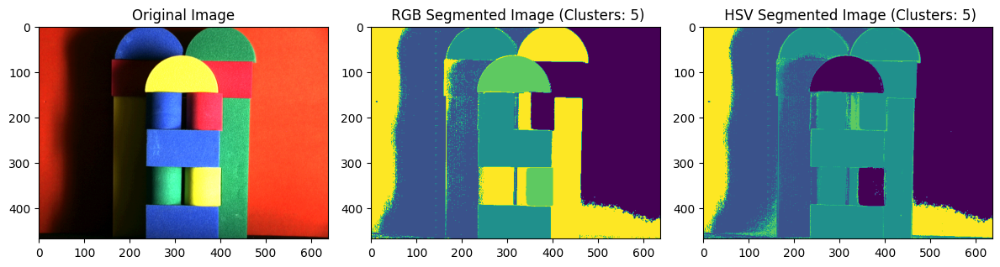

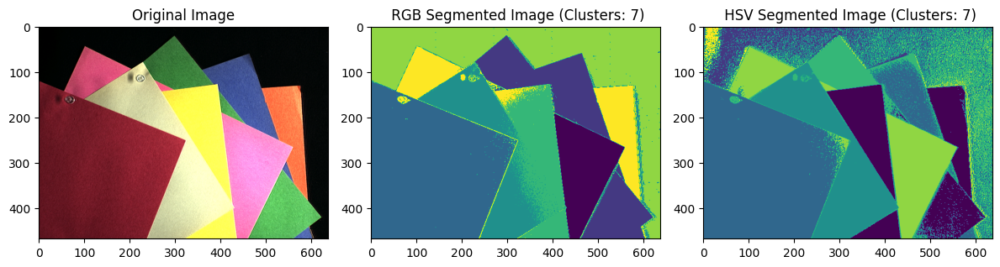

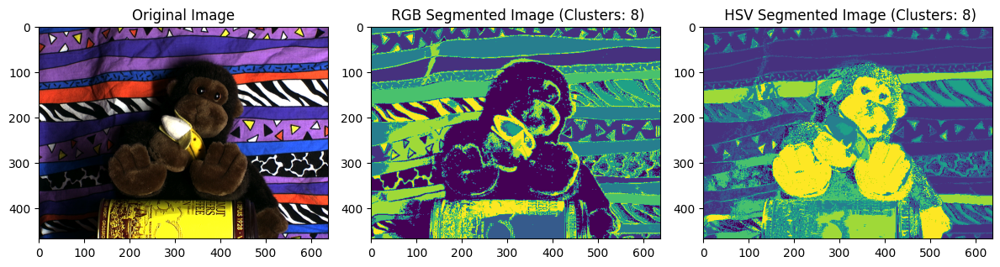

In [ ]:
features_ds1, labels_ds1,bic_ds1,features_hsv_ds1,labels_hsv_ds1, bic_hsv_ds1=plot_images_with_segmentation(images_ds1,number_of_clusters_ds1)

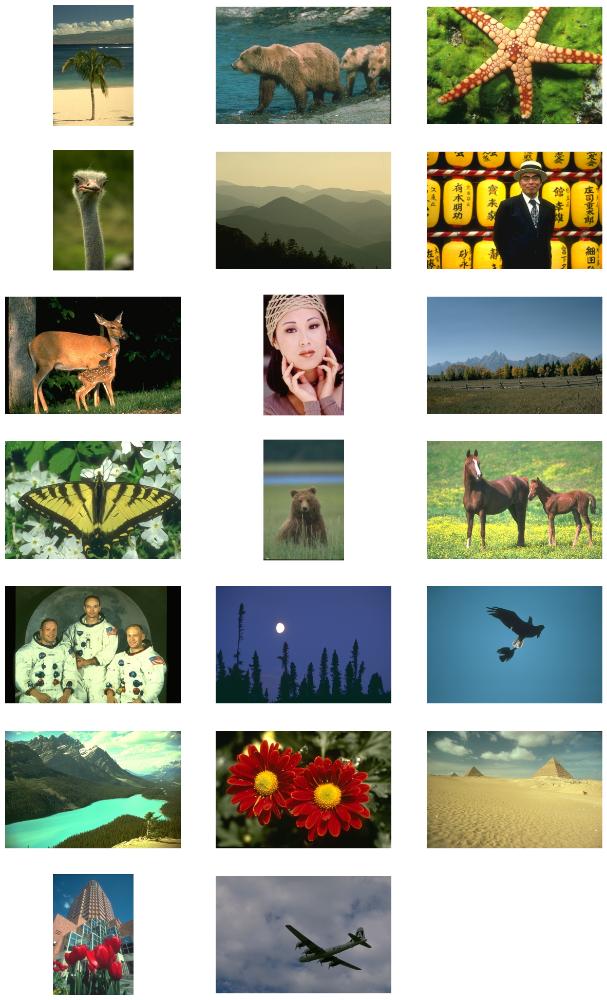

In [ ]:
folder_path = '/content/drive/MyDrive/GMM/bdsd_images'

image_files = glob.glob(folder_path + '/*.jpg')

num_images = len(image_files)
rows = (num_images // 3) + 1
cols = 3

fig, axs = plt.subplots(rows, cols, figsize=(15, 25))

images_ds2=[]

for i, image_file in enumerate(image_files):
    row = i // cols
    col = i % cols
    img = Image.open(image_file)
    images_ds2.append(np.array(img))

    axs[row, col].imshow(img)
    axs[row, col].axis('off')

for i in range(num_images, rows * cols):
    axs.flat[i].set_visible(False)

plt.show()

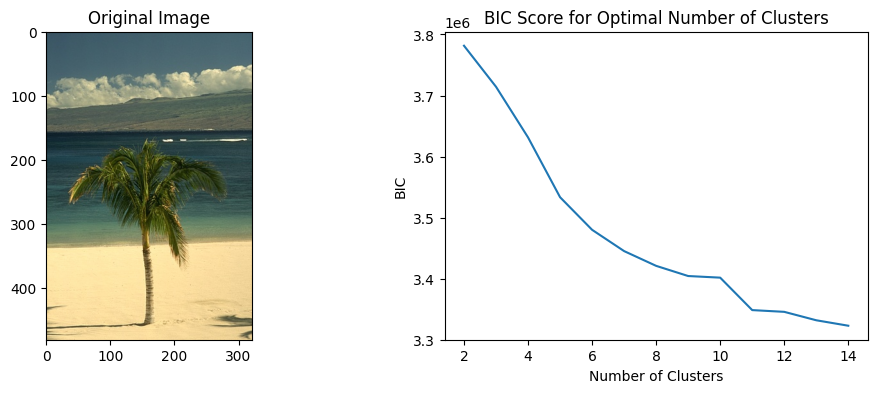

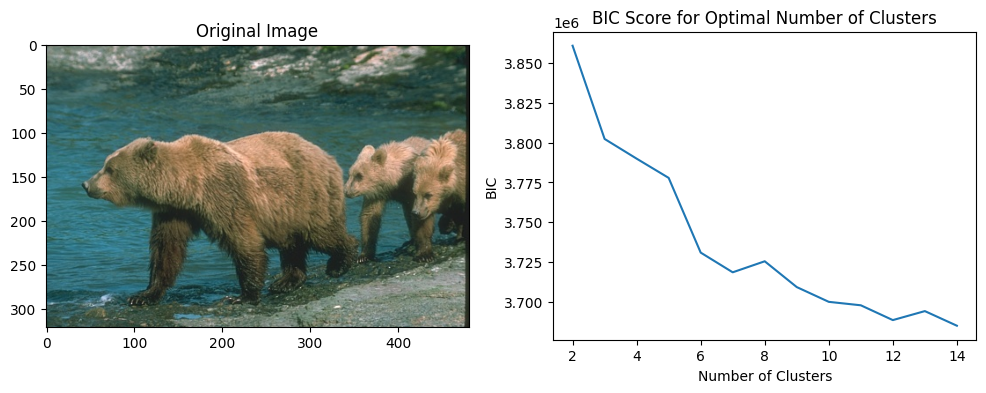

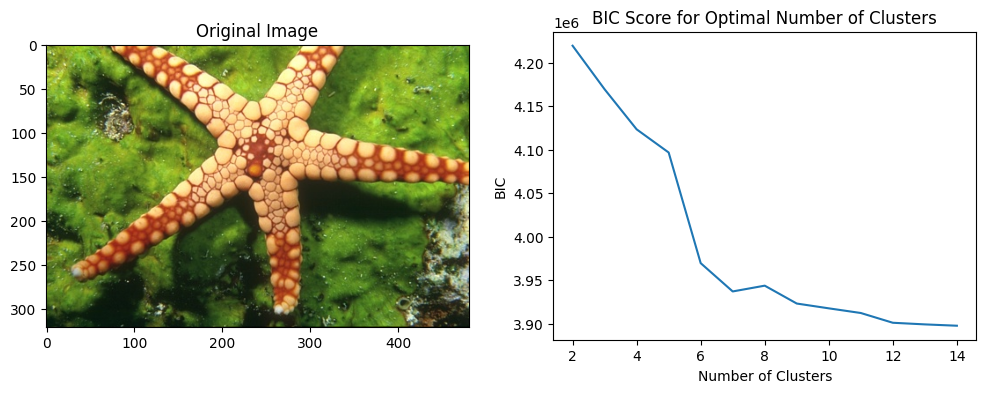

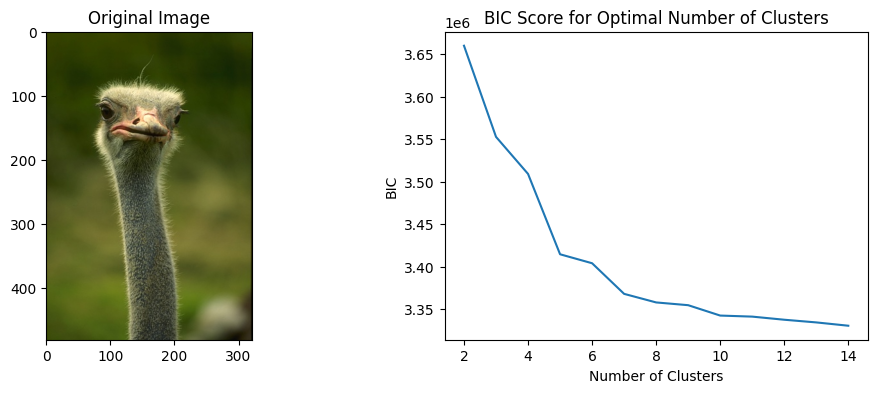

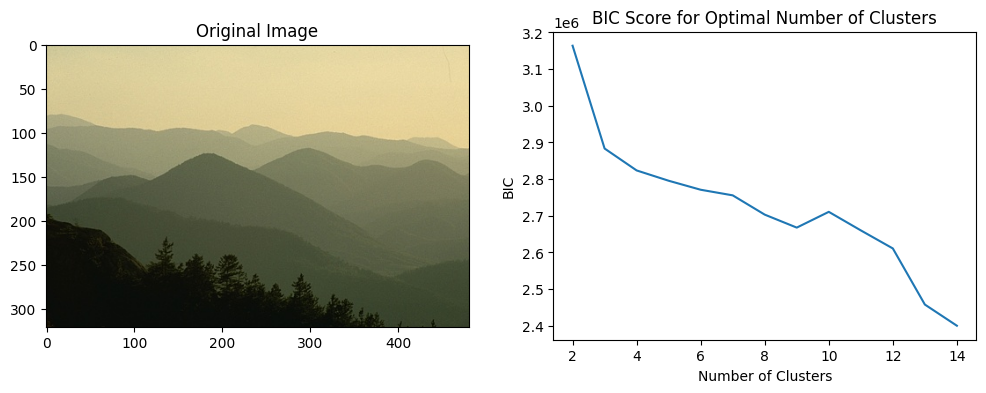

...

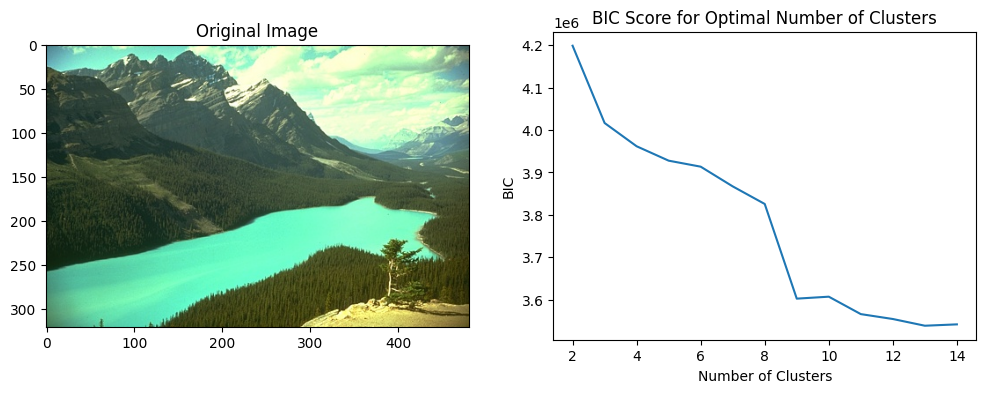

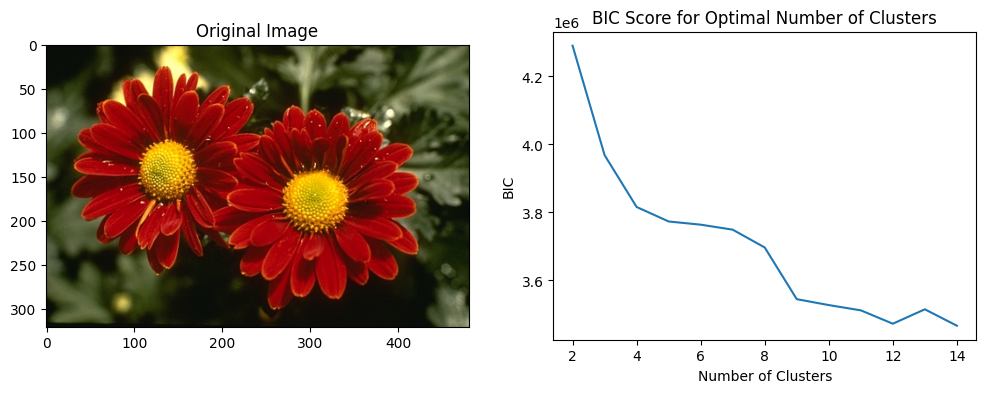

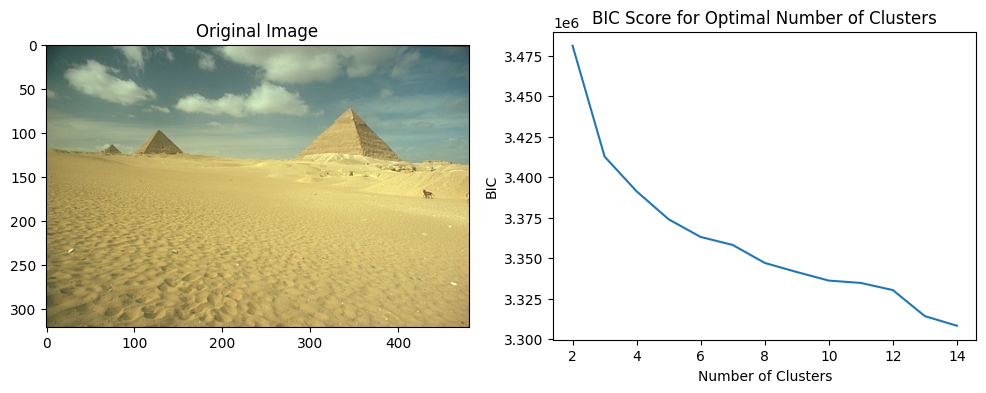

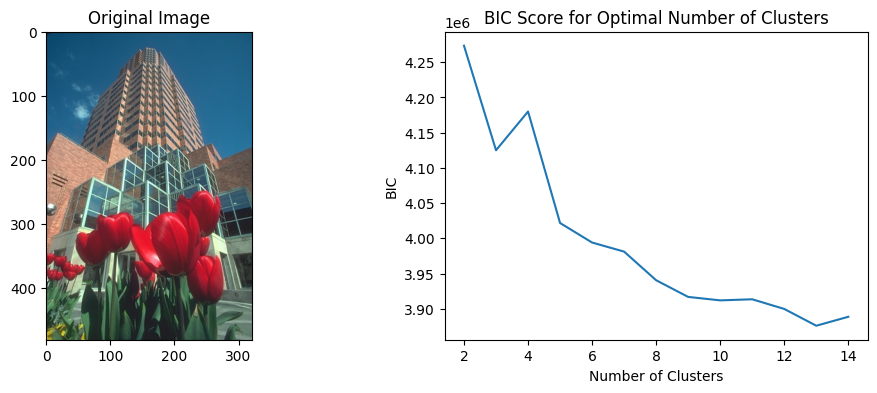

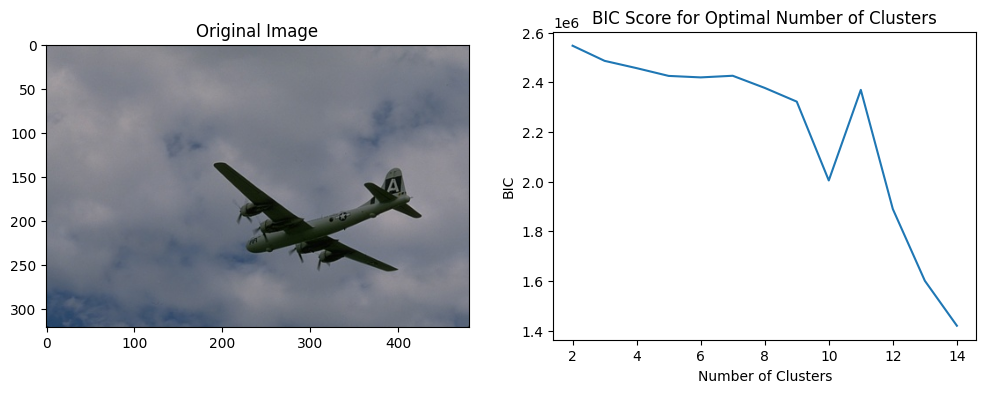

In [ ]:
plot_optimal_number_of_clusters(images_ds2)

In [ ]:
number_of_clusters_ds2=[6,3,5,3,4,4,5,6,5,4,4,6,4,3,2,4,4,3,5,2]

In [ ]:
features_ds2, labels_ds2, bic_ds2, features_hsv_ds2,labels_hsv_ds2, bic_hsv_ds2=plot_images_with_segmentation(images_ds2, number_of_clusters_ds2)

In [ ]:
def get_dataset_evaluations(image_features,predictions):
  davies_bouldin_indexes=[]
  calinski_harabasz_indexes=[]
  for features, labels in zip(image_features,predictions):
    davies_bouldin_index=davies_bouldin_score(features, labels)
    calinski_harabasz_index = calinski_harabasz_score(features, labels)
    davies_bouldin_indexes.append(davies_bouldin_index)
    calinski_harabasz_indexes.append(calinski_harabasz_index)
  return davies_bouldin_indexes, calinski_harabasz_indexes

In [ ]:
davies_bouldin_ds1,calinski_harabasz_ds1=get_dataset_evaluations(features_ds1,labels_ds1)

In [ ]:
davies_bouldin_hsv_ds1,calinski_harabasz_hsv_ds1=get_dataset_evaluations(features_hsv_ds1,labels_hsv_ds1)

In [ ]:
davies_bouldin_ds2,calinski_harabasz_ds2=get_dataset_evaluations(features_ds2,labels_ds2)

In [ ]:
davies_bouldin_hsv_ds2,calinski_harabasz_hsv_ds2=get_dataset_evaluations(features_hsv_ds2,labels_hsv_ds2)

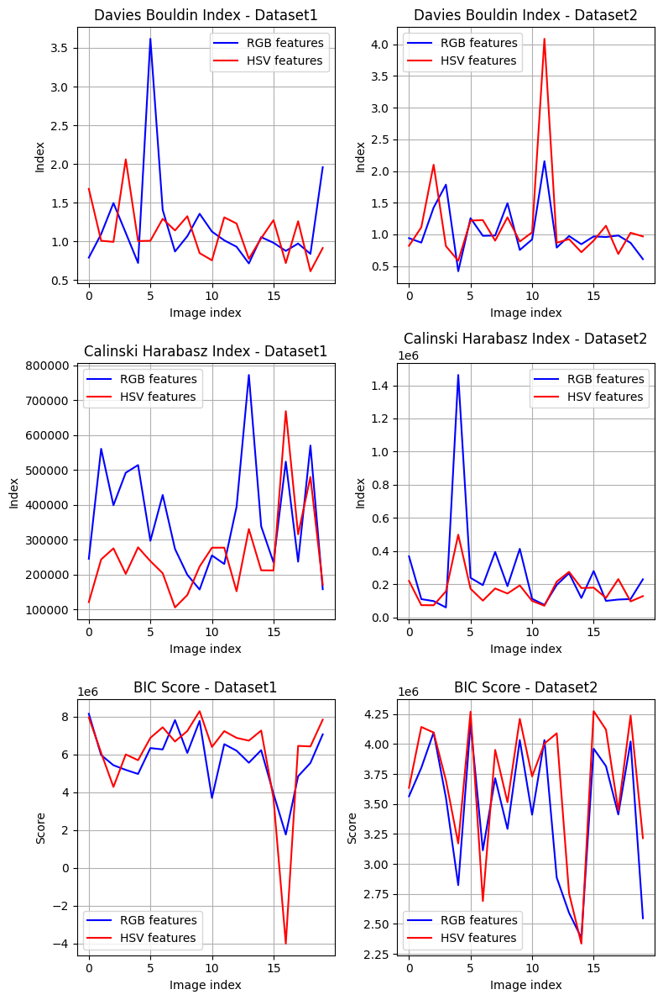

In [ ]:
fig, axs = plt.subplots(3, 2, figsize=(8, 12))

axs[0][0].plot(davies_bouldin_ds1, color='blue', label='RGB features')
axs[0][0].plot(davies_bouldin_hsv_ds1, color='red', label='HSV features')
axs[0][0].set_title('Davies Bouldin Index - Dataset1')
axs[0][0].set_xlabel('Image index')
axs[0][0].set_ylabel('Index')
axs[0][0].legend()
axs[0][0].grid(True)

axs[0][1].plot(davies_bouldin_ds2, color='blue', label='RGB features')
axs[0][1].plot(davies_bouldin_hsv_ds2, color='red', label='HSV features')
axs[0][1].set_title('Davies Bouldin Index - Dataset2')
axs[0][1].set_xlabel('Image index')
axs[0][1].set_ylabel('Index')
axs[0][1].legend()
axs[0][1].grid(True)

axs[1][0].plot(calinski_harabasz_ds1, color='blue', label='RGB features')
axs[1][0].plot(calinski_harabasz_hsv_ds1, color='red', label='HSV features')
axs[1][0].set_title('Calinski Harabasz Index - Dataset1')
axs[1][0].set_xlabel('Image index')
axs[1][0].set_ylabel('Index')
axs[1][0].legend()
axs[1][0].grid(True)

axs[1][1].plot(calinski_harabasz_ds2, color='blue', label='RGB features')
axs[1][1].plot(calinski_harabasz_hsv_ds2, color='red', label='HSV features')
axs[1][1].set_title('Calinski Harabasz Index - Dataset2')
axs[1][1].set_xlabel('Image index')
axs[1][1].set_ylabel('Index')
axs[1][1].legend()
axs[1][1].grid(True)

axs[2][0].plot(bic_ds1, color='blue', label='RGB features')
axs[2][0].plot(bic_hsv_ds1, color='red', label='HSV features')
axs[2][0].set_title('BIC Score - Dataset1')
axs[2][0].set_xlabel('Image index')
axs[2][0].set_ylabel('Score')
axs[2][0].legend()
axs[2][0].grid(True)

axs[2][1].plot(bic_ds2, color='blue', label='RGB features')
axs[2][1].plot(bic_hsv_ds2, color='red', label='HSV features')
axs[2][1].set_title('BIC Score - Dataset2')
axs[2][1].set_xlabel('Image index')
axs[2][1].set_ylabel('Score')
axs[2][1].legend()
axs[2][1].grid(True)

plt.tight_layout()
plt.show()

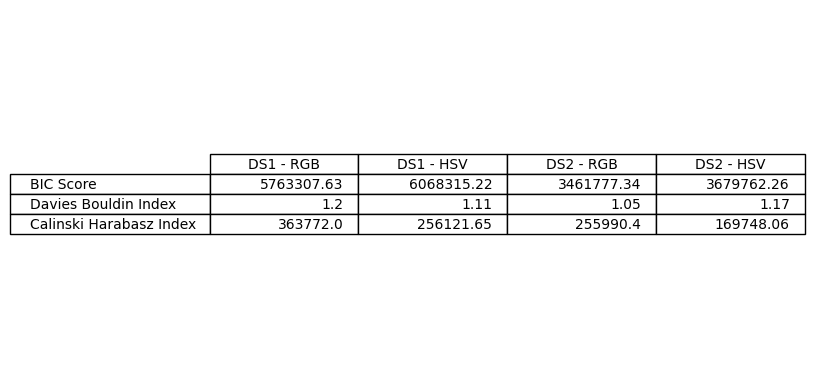

In [ ]:
data = [[round(np.average(bic_ds1),2),round(np.average(bic_hsv_ds1),2),round(np.average(bic_ds2),2),round(np.average(bic_hsv_ds2),2)],
  [round(np.average(davies_bouldin_ds1),2),round(np.average(davies_bouldin_hsv_ds1),2),round(np.average(davies_bouldin_ds2),2),round(np.average(davies_bouldin_hsv_ds2),2)],
  [round(np.average(calinski_harabasz_ds1),2),round(np.average(calinski_harabasz_hsv_ds1),2),round(np.average(calinski_harabasz_ds2),2),round(np.average(calinski_harabasz_hsv_ds2),2)]]

fig, ax = plt.subplots()

table = ax.table(cellText=data, colLabels=['DS1 - RGB','DS1 - HSV', 'DS2 - RGB', 'DS2 - HSV'], rowLabels=['BIC Score',  'Davies Bouldin Index', 'Calinski Harabasz Index'],
                 loc='center')

table.auto_set_font_size(False)
table.set_fontsize(10)
table.scale(1.2, 1.2)

ax.axis('off')

plt.show()

In [ ]:
silhouette_avg = silhouette_score(features_ds1[4], labels_ds1[4])
print(f"Silhouette Score for image #5 in DS1: {silhouette_avg}")

Silhouette Score for image #5 in DS1: 0.7336725732435088


In [ ]:
def get_silhouette_scores(features_list,labels_list):
  silhouette_scores=[]
  for features, labels in zip(features_list,labels_list):
    silhouette_avg=silhouette_score(features,labels)
    silhouette_scores.append(silhouette_avg)
  return silhouette_scores

[0.44058240898031836, 0.3236658834923495, 0.29764305237156635, 0.36728046886241456, 0.7249434358409066, 0.5002120527815246, 0.2589459014867967, 0.29247740565641533, 0.22615154813238178, 0.47065913663857667, 0.36987593149437853, 0.24241284444862624, 0.3459431372779374, 0.683105835945229, 0.7578901179305236, 0.5395038341163712, 0.4162829579783685, 0.4043759491462293, 0.3991995997553814, 0.7532483314006181]


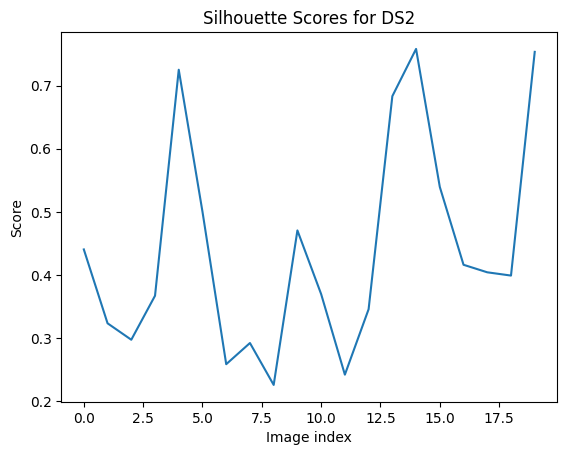

In [ ]:
silhouette_scores=get_silhouette_scores(features_ds2, labels_ds2)
print(silhouette_scores)

plt.plot(silhouette_scores)

plt.xlabel('Image index')
plt.ylabel('Score')
plt.title('Silhouette Scores for DS2')

plt.show()

In [ ]:
scores=[0.44058240898031836, 0.3236658834923495, 0.29764305237156635, 0.36728046886241456, 0.7249434358409066, 0.5002120527815246, 0.2589459014867967, 0.29247740565641533, 0.22615154813238178, 0.47065913663857667, 0.36987593149437853, 0.24241284444862624, 0.3459431372779374, 0.683105835945229, 0.7578901179305236, 0.5395038341163712, 0.4162829579783685, 0.4043759491462293, 0.3991995997553814, 0.7532483314006181]
print(f"Average silhouette score: {np.average(scores)}")

Average silhouette score: 0.4407199916868456


In [ ]:
def parse_ground_truth(ground_truth_data, image_shape):
    ground_truth_mask = np.zeros(image_shape, dtype=int)

    in_data_section = False
    for line in ground_truth_data:
        if line.startswith('data'):
            in_data_section = True
            continue

        if not in_data_section:
            continue

        if len(line)>1:
          label, y, start_x, end_x = map(int, line.split())
          if label != 0:
            ground_truth_mask[y, start_x:end_x + 1] = label

    return ground_truth_mask


def read_seg_file(file_path):
    with open(file_path, 'r') as file:
        return file.read().split('\n')

In [ ]:
def calculate_pixel_accuracy(ground_truth, predicted):
    correct_pixels = np.sum(ground_truth == predicted)
    total_pixels = np.prod(ground_truth.shape)
    accuracy = correct_pixels / total_pixels
    return accuracy

def calculate_iou(ground_truth, predicted):
    intersection = np.logical_and(ground_truth, predicted)
    union = np.logical_or(ground_truth, predicted)
    iou = np.sum(intersection) / np.sum(union)
    return iou

Intersection over Union (IoU): 0.7084516772856375
Pixel Accuracy: 0.9754017137194707


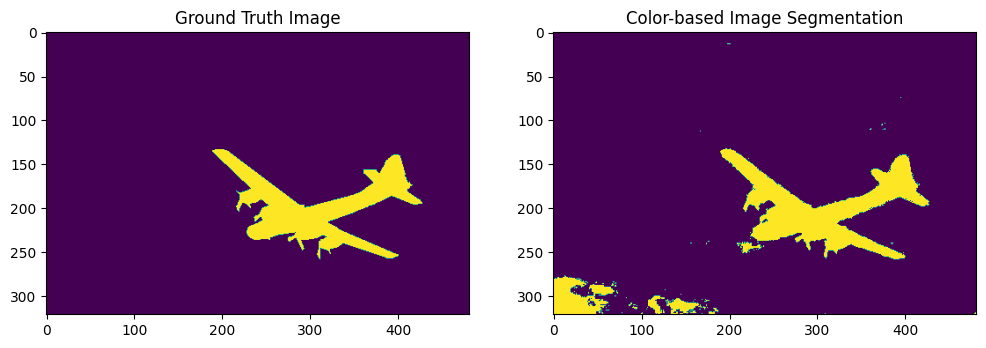

In [ ]:
image_segmentation=labels_ds2[19].reshape(images_ds2[19].shape[:2])

seg_path='/content/drive/MyDrive/GMM/3096.seg'
gt_data=read_seg_file(seg_path)
gt_mask = parse_ground_truth(gt_data, image_segmentation.shape)

iou_score = calculate_iou(gt_mask, image_segmentation)
print("Intersection over Union (IoU):", iou_score)

pixel_accuracy = calculate_pixel_accuracy(gt_mask, image_segmentation)
print("Pixel Accuracy:", pixel_accuracy)

plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.imshow(gt_mask, cmap='viridis')
plt.title('Ground Truth Image')

plt.subplot(1, 2, 2)
plt.imshow(image_segmentation, cmap='viridis')
plt.title('Color-based Image Segmentation')

plt.show()

In [ ]:
rgbfeatures=images_ds2[3].reshape((-1,3))

gmm = GaussianMixture(n_components=2,covariance_type="full")
gmm.fit(rgbfeatures)

assignments = gmm.predict(rgbfeatures)

res=assignments.reshape(images_ds2[3].shape[:2])

Intersection over Union (IoU): 0.8974320110860904
Pixel Accuracy: 0.9349227012778415


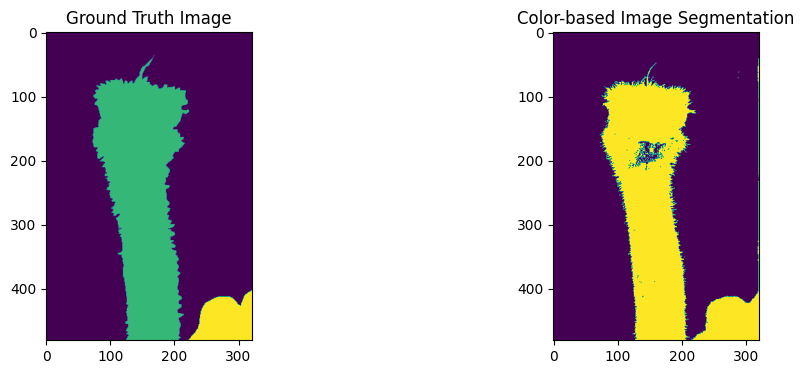

In [ ]:
seg_path='/content/drive/MyDrive/GMM/66075.seg'
gt_data=read_seg_file(seg_path)
gt_mask = parse_ground_truth(gt_data, res.shape)

segmentation = [[2 if value == 0 else 0 for value in row] for row in res]

iou_score = calculate_iou(gt_mask, segmentation)
print("Intersection over Union (IoU):", iou_score)

pixel_accuracy = calculate_pixel_accuracy(gt_mask, segmentation)
print("Pixel Accuracy:", pixel_accuracy)

plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.imshow(gt_mask, cmap='viridis')
plt.title('Ground Truth Image')

plt.subplot(1, 2, 2)
plt.imshow(segmentation, cmap='viridis')
plt.title('Color-based Image Segmentation')

plt.show()